<a href="https://colab.research.google.com/github/mattemugno/Smart-Waste-Classifation/blob/main/Convnet_behaviour_visualization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

In [ ]:
import tensorflow as tf
import tensorflow.keras as keras
import os
import numpy as np
from IPython.display import display
from google.colab import drive
import shutil
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras import layers
from keras.models import Model
import random as rn
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import matplotlib as mpl
import matplotlib.cm as cm
import cv2
from google.colab.patches import cv2_imshow

In [ ]:
drive.mount('/content/drive/', force_remount=True)
!unzip -q "/content/drive/My Drive/project/SplittedDataset.zip" -d "/content/dataset/"
dataset_path = "/content/dataset/content/splitted_dataset"

Mounted at /content/drive/


In [ ]:
MODELS_DIR = "/content/drive/My Drive/project/models/"
resnet_model = tf.keras.models.load_model(MODELS_DIR + 'garbage_classification_pretrained_base.h5')

In [ ]:
resnet_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.math.truediv (TFOpLambda  (None, 224, 224, 3)      0         
 )                                                               
                                                                 
 tf.math.subtract (TFOpLambd  (None, 224, 224, 3)      0         
 a)                                                              
                                                                 
 resnet50v2 (Functional)     (None, 7, 7, 2048)        23564800  
                                                                 
 my_glo_avg_pool (GlobalAver  (None, 2048)             0         
 agePooling2D)                                                   
                                                             

In [ ]:
def set_seed ():
  ''' 
  set_seed is used to obtain reproducible results using keras during the development phase
  '''
  seed = 24
  os.environ["PYTHONHASHSEED"]="0"
  np.random.seed(seed)
  rn.seed(seed)
  tf.random.set_seed(seed)

set_seed()

def get_index_by_layer_name(model, layer_name):
  '''
  get_index_by_layer_name is used to retrieve the index of a specific layer
  :param model: model to check
  :param layer_name: name of the layer we want to get the index of
  :return: the index of the layer named as defined in layer_name
  '''
  for index, layer in enumerate(model.layers):
      if layer.name == layer_name:
          return index

# Intermediate activations
Visualizing intermediate activations consists in displaying the feature maps that are output by various convolution and pooling layers in a network, given a certain input

In [ ]:
images_per_row = 16 # how many images per row to show

In [ ]:
def get_layer_names_and_outputs (model):
  '''
  get_layer_names is used to get all the conv and max pooling layers names and outputs
  :param model: model considered
  :return: a tuple (layer_names, layer_outputs)
  '''
  layer_outputs = []
  layer_names = []
  for layer in model.layers:
      if isinstance(layer, (layers.Conv2D, layers.MaxPooling2D)):
          layer_outputs.append(layer.output)
          layer_names.append(layer.name)
  return layer_names, layer_outputs

def print_intermediate_activations(layer_names, activations, how_many_layers_to_show=None, how_many_layers_to_skip=0):
  '''
  print_intermediate_activations is used to print the intermediate activations
  :param layer_names: names of the layers
  :param activations: activation values of the convolutional and pooling layers
  :param how_many_layers_to_show: how many layers to show in the print
  :param how_many_layers_to_skip: how many layers to skip in the print
  '''

  layer_names = layer_names[how_many_layers_to_skip:]
  activations = activations[how_many_layers_to_skip:]

  count_layers = 0
  for layer_name, layer_activation in zip(layer_names, activations):

      count_layers += 1
      if how_many_layers_to_show: # not None
        if count_layers > how_many_layers_to_show:
          break

      n_features = layer_activation.shape[-1]
      size = layer_activation.shape[1]

      n_cols = n_features // images_per_row
      display_grid = np.zeros((size * n_cols, images_per_row * size))

      for col in range(n_cols):
          for row in range(images_per_row):
              channel_image = layer_activation[0,:, :, col * images_per_row + row]
              channel_image -= channel_image.mean() 
              channel_image /= channel_image.std() 
              channel_image *= 64 
              channel_image += 128
              channel_image = np.clip(channel_image, 0, 255).astype('uint8')
              display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image

      # Display the grid
      scale = 1. / size
      plt.figure(figsize=(scale * display_grid.shape[1],
                          scale * display_grid.shape[0]))
      plt.title(layer_name)
      plt.grid(False)
      plt.imshow(display_grid, aspect='auto', cmap='gray')
      
  plt.show()

In [ ]:
classes = ['plastic', 'organic', 'metal', 'battery', 'trash', 'glass', 'paper', 'clothes']
dict_labels ={"battery":0, "clothes":1, "glass":2, "metal":3, "organic":4, "paper":5, "plastic":6, "trash":7}
selected_class = rn.choice(classes)
sample_imgs = os.listdir(dataset_path + "/test_set/" + selected_class + "/")
sample_image = rn.choice([a for a in sample_imgs])
img_path = dataset_path + "/test_set/" + selected_class + "/" + sample_image
print(img_path)

/content/dataset/content/splitted_dataset/test_set/plastic/plastic470.jpg


In [ ]:
image_height = 224
image_width = 224
img = image.load_img(img_path, target_size=(image_height, image_width))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0) # add batch dimension

print(img_tensor.shape)

(1, 224, 224, 3)


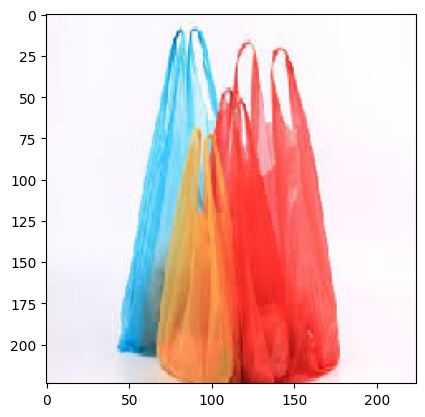

In [ ]:
plt.imshow(img_tensor[0].astype('uint8'))
plt.show()

In [ ]:
model = resnet_model.get_layer('resnet50v2') # focus only on the base network, in which there are conv layers

In [ ]:
layer_names, layer_outputs = get_layer_names_and_outputs(model)
print('How many layers: ', len(layer_names))
print(layer_names)
print(layer_outputs)
activation_model = keras.Model(inputs=model.input, outputs=layer_outputs) # one input and multiple output

How many layers:  57
['conv1_conv', 'pool1_pool', 'conv2_block1_1_conv', 'conv2_block1_2_conv', 'conv2_block1_0_conv', 'conv2_block1_3_conv', 'conv2_block2_1_conv', 'conv2_block2_2_conv', 'conv2_block2_3_conv', 'conv2_block3_1_conv', 'conv2_block3_2_conv', 'max_pooling2d', 'conv2_block3_3_conv', 'conv3_block1_1_conv', 'conv3_block1_2_conv', 'conv3_block1_0_conv', 'conv3_block1_3_conv', 'conv3_block2_1_conv', 'conv3_block2_2_conv', 'conv3_block2_3_conv', 'conv3_block3_1_conv', 'conv3_block3_2_conv', 'conv3_block3_3_conv', 'conv3_block4_1_conv', 'conv3_block4_2_conv', 'max_pooling2d_1', 'conv3_block4_3_conv', 'conv4_block1_1_conv', 'conv4_block1_2_conv', 'conv4_block1_0_conv', 'conv4_block1_3_conv', 'conv4_block2_1_conv', 'conv4_block2_2_conv', 'conv4_block2_3_conv', 'conv4_block3_1_conv', 'conv4_block3_2_conv', 'conv4_block3_3_conv', 'conv4_block4_1_conv', 'conv4_block4_2_conv', 'conv4_block4_3_conv', 'conv4_block5_1_conv', 'conv4_block5_2_conv', 'conv4_block5_3_conv', 'conv4_block6_1_c

In [ ]:
activations = activation_model.predict(img_tensor)
for out in activations:
  print(out.shape)

1/1 [==============================] - 1s 1s/step
(1, 112, 112, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 256)
(1, 56, 56, 64)
(1, 28, 28, 64)
(1, 28, 28, 256)
(1, 28, 28, 256)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 128)
(1, 14, 14, 128)
(1, 14, 14, 512)
(1, 14, 14, 512)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 1024)
(1, 14, 14, 1024)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 1024)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 1024)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 1024)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 1024)
(1, 14, 14, 256)
(1, 7, 7, 256)
(1, 7, 7, 1024)
(1, 7, 7, 1024)
(1, 7, 7, 512)
(1, 7, 7, 512)
(1, 7, 7, 2048)
(1, 7, 7, 2048)
(1, 7, 7, 512)
(1, 7, 7, 512)
(1, 7, 7, 2048)
(1, 7, 7, 512)
(1, 7, 7, 512)
(1, 7, 7, 2048)


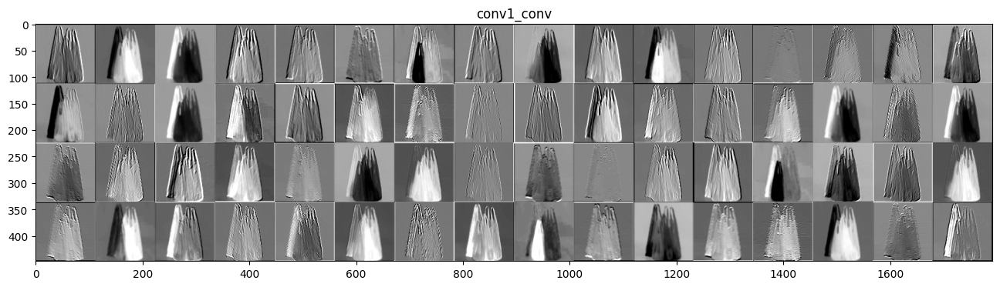

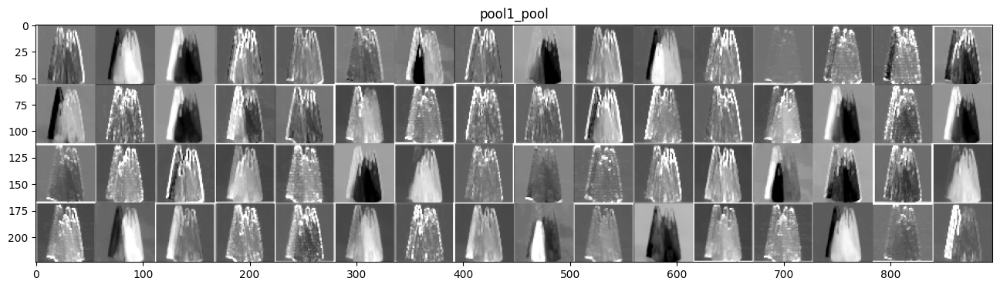

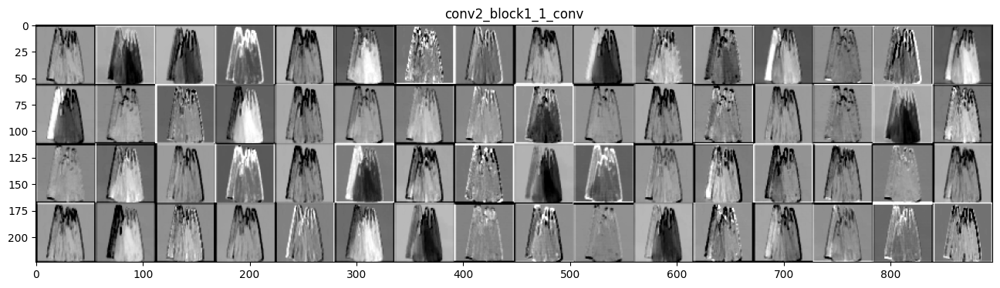

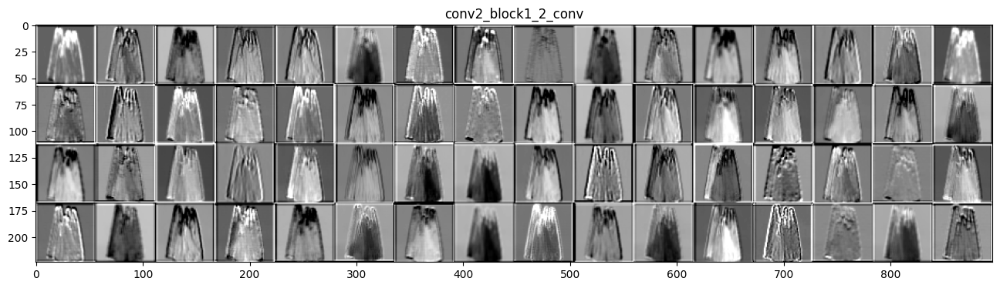

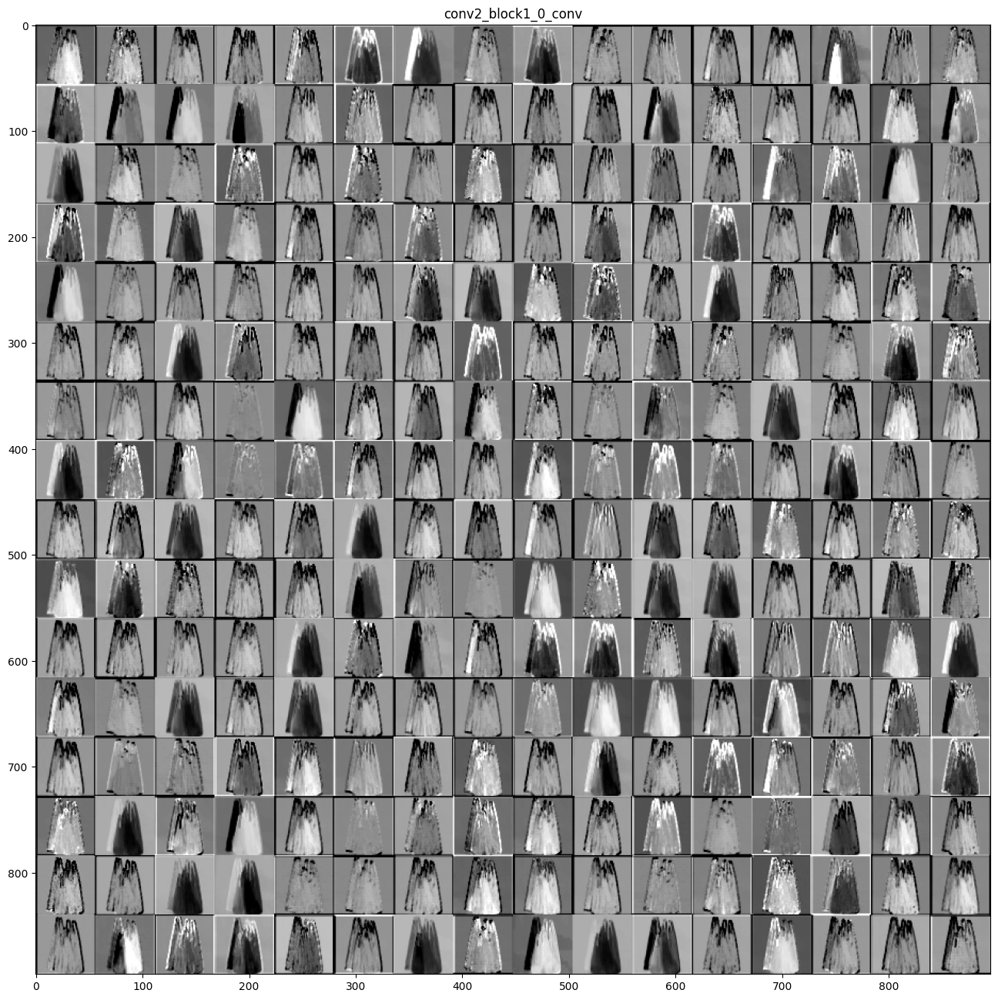

...

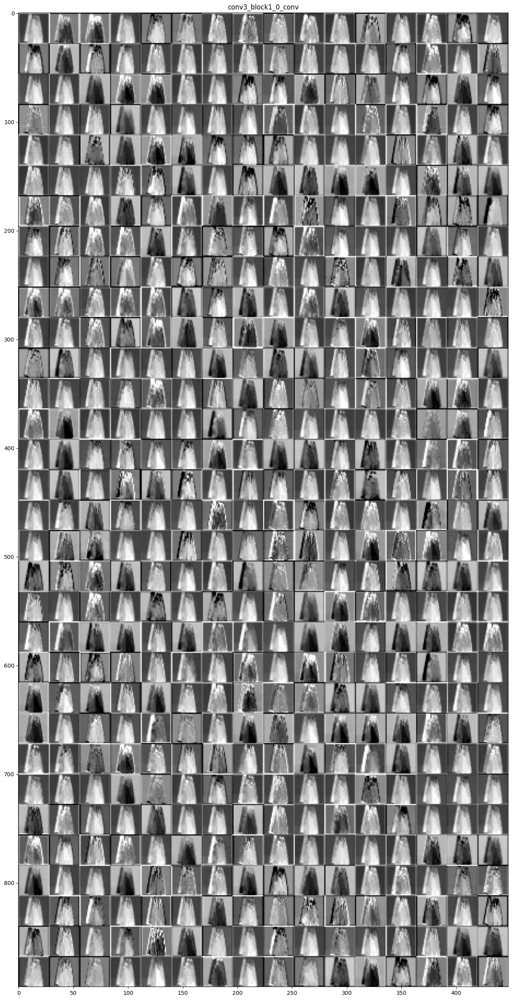

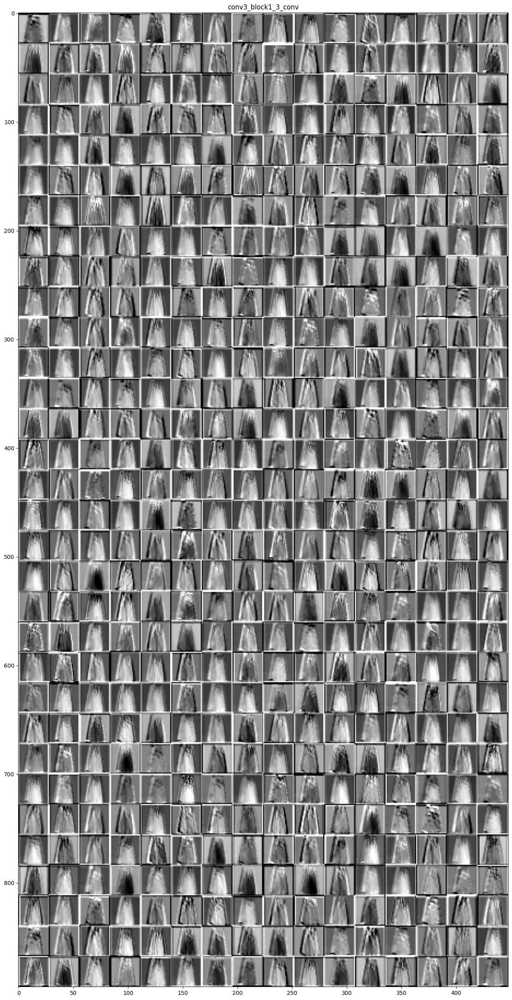

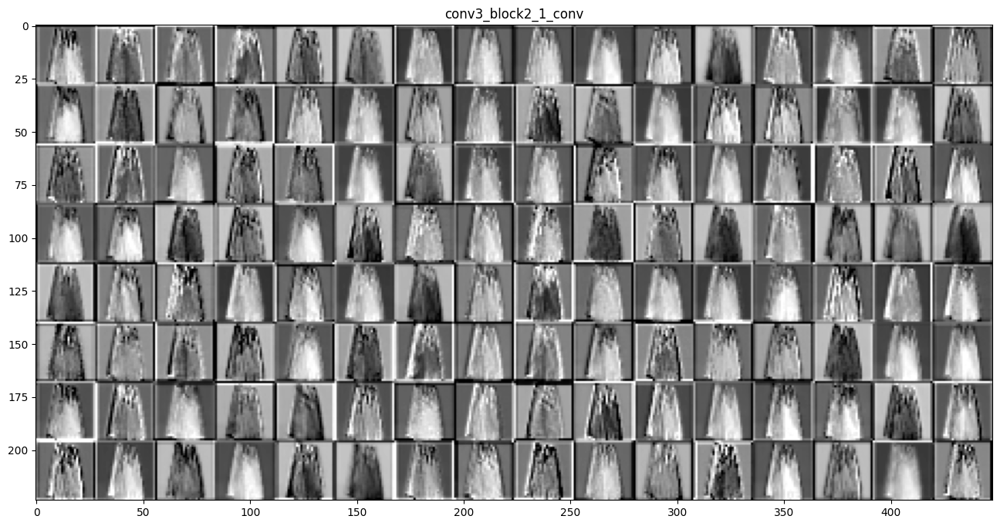

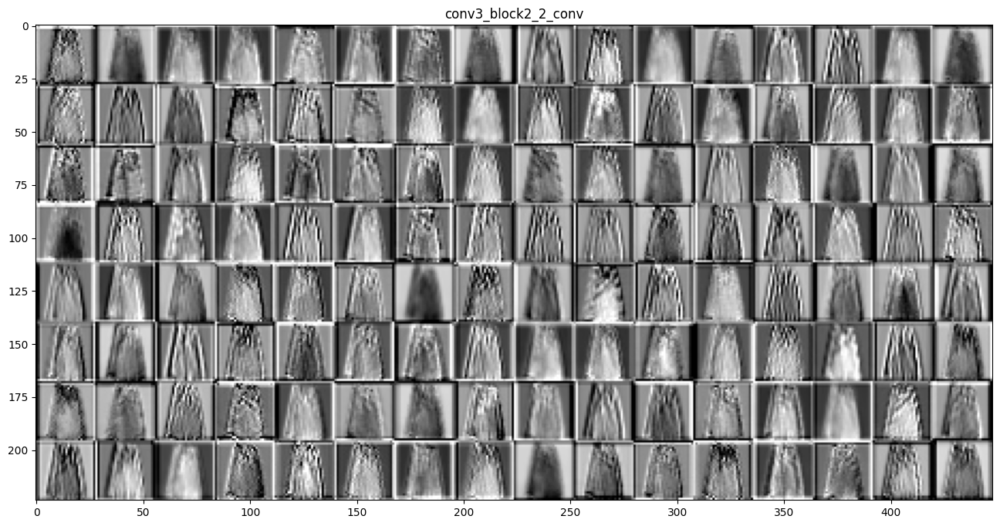

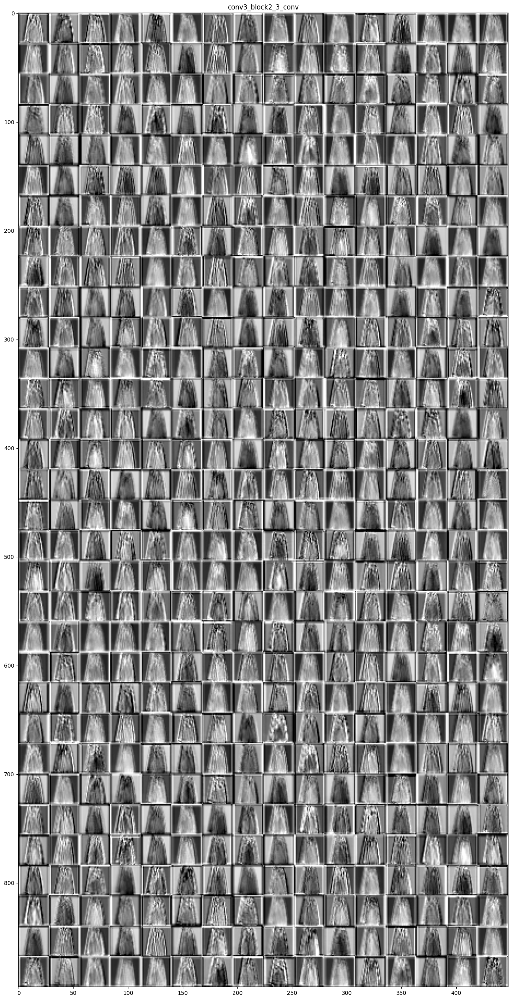

In [ ]:
print_intermediate_activations(layer_names, activations, how_many_layers_to_show=20)

# Visualizing convnet filters

In [ ]:
resnet_model = tf.keras.models.load_model(MODELS_DIR + 'garbage_classification_pretrained_fine_tuned.h5')

In [ ]:
resnet_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.math.truediv (TFOpLambda  (None, 224, 224, 3)      0         
 )                                                               
                                                                 
 tf.math.subtract (TFOpLambd  (None, 224, 224, 3)      0         
 a)                                                              
                                                                 
 resnet50v2 (Functional)     (None, 7, 7, 2048)        23564800  
                                                                 
 my_glo_avg_pool (GlobalAver  (None, 2048)             0         
 agePooling2D)                                                   
                                                             

In [ ]:
layer_names, layer_outputs = get_layer_names_and_outputs(model)
print('How many layers: ', len(layer_names))
print(layer_names)

How many layers:  57
['conv1_conv', 'pool1_pool', 'conv2_block1_1_conv', 'conv2_block1_2_conv', 'conv2_block1_0_conv', 'conv2_block1_3_conv', 'conv2_block2_1_conv', 'conv2_block2_2_conv', 'conv2_block2_3_conv', 'conv2_block3_1_conv', 'conv2_block3_2_conv', 'max_pooling2d', 'conv2_block3_3_conv', 'conv3_block1_1_conv', 'conv3_block1_2_conv', 'conv3_block1_0_conv', 'conv3_block1_3_conv', 'conv3_block2_1_conv', 'conv3_block2_2_conv', 'conv3_block2_3_conv', 'conv3_block3_1_conv', 'conv3_block3_2_conv', 'conv3_block3_3_conv', 'conv3_block4_1_conv', 'conv3_block4_2_conv', 'max_pooling2d_1', 'conv3_block4_3_conv', 'conv4_block1_1_conv', 'conv4_block1_2_conv', 'conv4_block1_0_conv', 'conv4_block1_3_conv', 'conv4_block2_1_conv', 'conv4_block2_2_conv', 'conv4_block2_3_conv', 'conv4_block3_1_conv', 'conv4_block3_2_conv', 'conv4_block3_3_conv', 'conv4_block4_1_conv', 'conv4_block4_2_conv', 'conv4_block4_3_conv', 'conv4_block5_1_conv', 'conv4_block5_2_conv', 'conv4_block5_3_conv', 'conv4_block6_1_c

In [ ]:
layer_name = "conv3_block1_1_conv"
layer = model.get_layer(name=layer_name)
feature_extractor = keras.Model(inputs=model.input, outputs=layer.output)

In [ ]:
classes = ['plastic', 'organic', 'metal', 'battery', 'trash', 'glass', 'paper', 'clothes']
dict_labels ={"battery":0, "clothes":1, "glass":2, "metal":3, "organic":4, "paper":5, "plastic":6, "trash":7}
selected_class = rn.choice(classes)
sample_imgs = os.listdir(dataset_path + "/test_set/" + selected_class + "/")
sample_image = rn.choice([a for a in sample_imgs])
img_path = dataset_path + "/test_set/" + selected_class + "/" + sample_image
print(img_path)

/content/dataset/content/splitted_dataset/test_set/battery/battery600.jpg


In [ ]:
# We preprocess the image into a 4D tensor (3D image + 1 batch dimension)
image_height = 224
image_width = 224
img = image.load_img(img_path, target_size=(image_height, image_width))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0) # add batch dimension

# Its shape is (1, image_height, image_width, 3)
print(img_tensor.shape)

(1, 224, 224, 3)


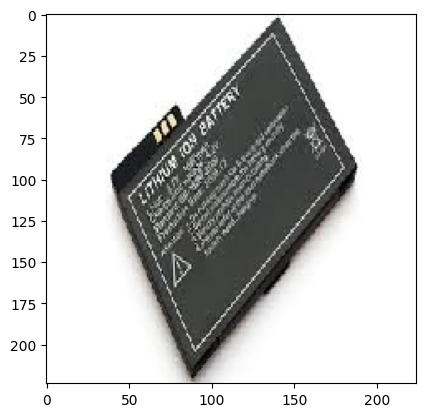

In [ ]:
plt.imshow(img_tensor[0].astype('uint8'))
plt.show()

In [ ]:
activation = feature_extractor(
    keras.applications.resnet_v2.preprocess_input(img_tensor)
)

In [ ]:
def compute_loss(image, layer_name, filter_index):
  ''' compute loss for gradient ascent
  
  image: input image tensor
  layer_name: name of the conv layer we are considering
  filter index: index of the filter we are considering (i.e., feature map of the output of a given conv layer) 
  '''
  layer = model.get_layer(name=layer_name)
  feature_extractor = keras.Model(inputs=model.input, outputs=layer.output)
  activation = feature_extractor(image)
  filter_activation = activation[:, 2:-2, 2:-2, filter_index] # avoid border artifacts
  return tf.reduce_mean(filter_activation) # return mean activation values for the filter

In [ ]:
def gradient_ascent_step(image, layer_name, filter_index, learning_rate):
    with tf.GradientTape() as tape: 
        tape.watch(image) 
        loss = compute_loss(image, layer_name, filter_index)
    grads = tape.gradient(loss, image) 
    grads = tf.math.l2_normalize(grads) 
    image += learning_rate * grads 
    return image

In [ ]:
img_width = 224
img_height = 224

def generate_filter_pattern(layer_name, filter_index):
    iterations = 30
    learning_rate = 10.
    image = tf.random.uniform( 
        minval=0.4,
        maxval=0.6,
        shape=(1, img_width, img_height, 3))
    for i in range(iterations):
        image = gradient_ascent_step(image, layer_name, filter_index, learning_rate)
    return image[0].numpy()

In [ ]:
def deprocess_image(image):
    image -= image.mean()
    image /= image.std()
    image *= 64
    image += 128
    image = np.clip(image, 0, 255).astype("uint8")
    image = image[25:-25, 25:-25, :] 
    return image

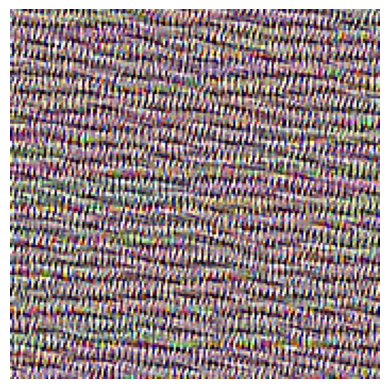

In [ ]:
plt.axis("off")
plt.imshow(deprocess_image(generate_filter_pattern(layer_name, filter_index=2)))

In [ ]:
all_images = []
for filter_index in range(16):
    print(f"Processing filter {filter_index}")
    image = deprocess_image(
        generate_filter_pattern(layer_name, filter_index)
    )
    all_images.append(image)

margin = 5
n = 4
cropped_width = img_width - 25 * 2
cropped_height = img_height - 25 * 2
width = n * cropped_width + (n - 1) * margin
height = n * cropped_height + (n - 1) * margin
stitched_filters = np.zeros((width, height, 3))

for i in range(n):
    for j in range(n):
        image = all_images[i * n + j]
        stitched_filters[
            (cropped_width + margin) * i : (cropped_width + margin) * i + cropped_width,
            (cropped_height + margin) * j : (cropped_height + margin) * j
            + cropped_height,
            :,
        ] = image

Processing filter 0
Processing filter 1
Processing filter 2
Processing filter 3
Processing filter 4
Processing filter 5
Processing filter 6
Processing filter 7
Processing filter 8
Processing filter 9
Processing filter 10
Processing filter 11
Processing filter 12
Processing filter 13
Processing filter 14
Processing filter 15


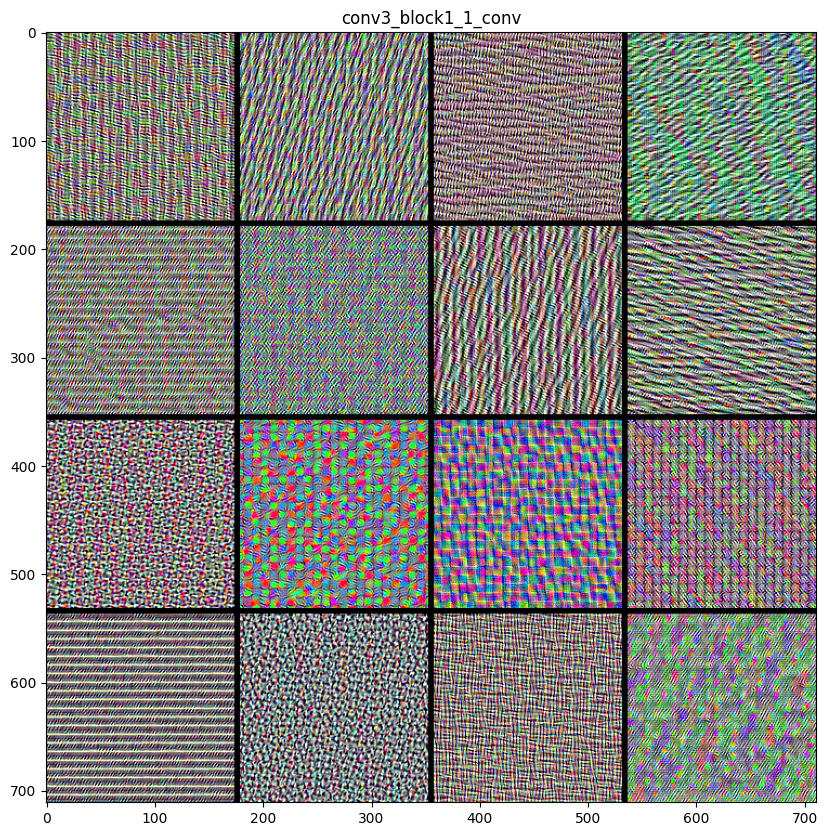

In [ ]:
plt.figure(figsize=(10, 10))
plt.title(layer_name)
plt.imshow(stitched_filters.astype("uint8"))
plt.show()


conv3_block2_1_conv

Processing filter 0
Processing filter 1
Processing filter 2
Processing filter 3
Processing filter 4
Processing filter 5
Processing filter 6
Processing filter 7
Processing filter 8
Processing filter 9
Processing filter 10
Processing filter 11
Processing filter 12
Processing filter 13
Processing filter 14
Processing filter 15


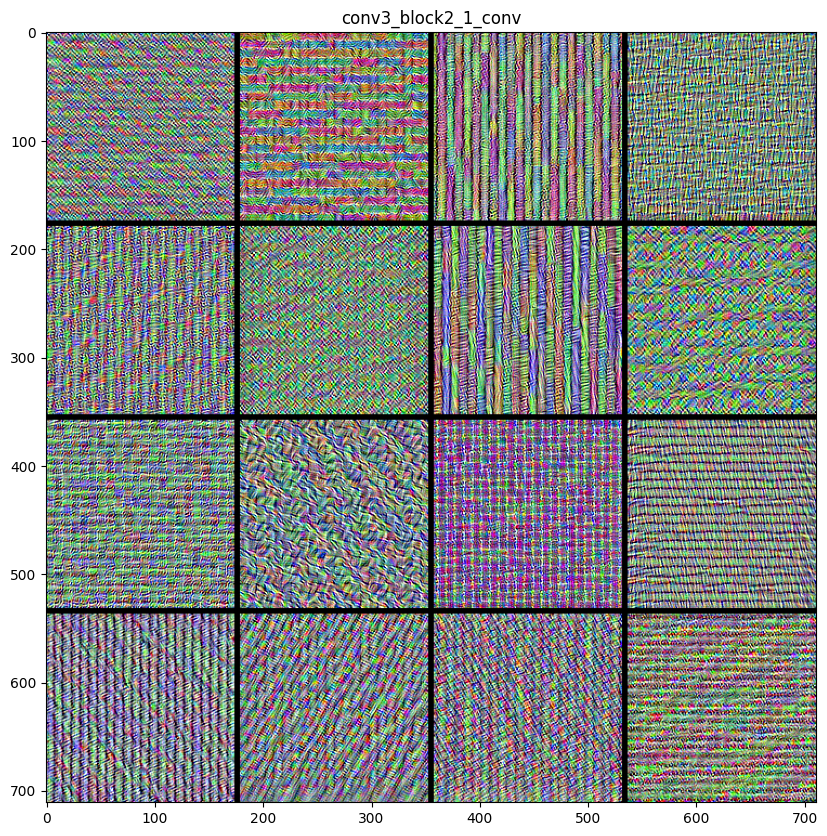


conv3_block3_1_conv

Processing filter 0
Processing filter 1
Processing filter 2
Processing filter 3
Processing filter 4
Processing filter 5
Processing filter 6
Processing filter 7
Processing filter 8
Processing filter 9
Processing filter 10
Processing filter 11
Processing filter 12
Processing filter 13
Processing filter 14
Processing filter 15


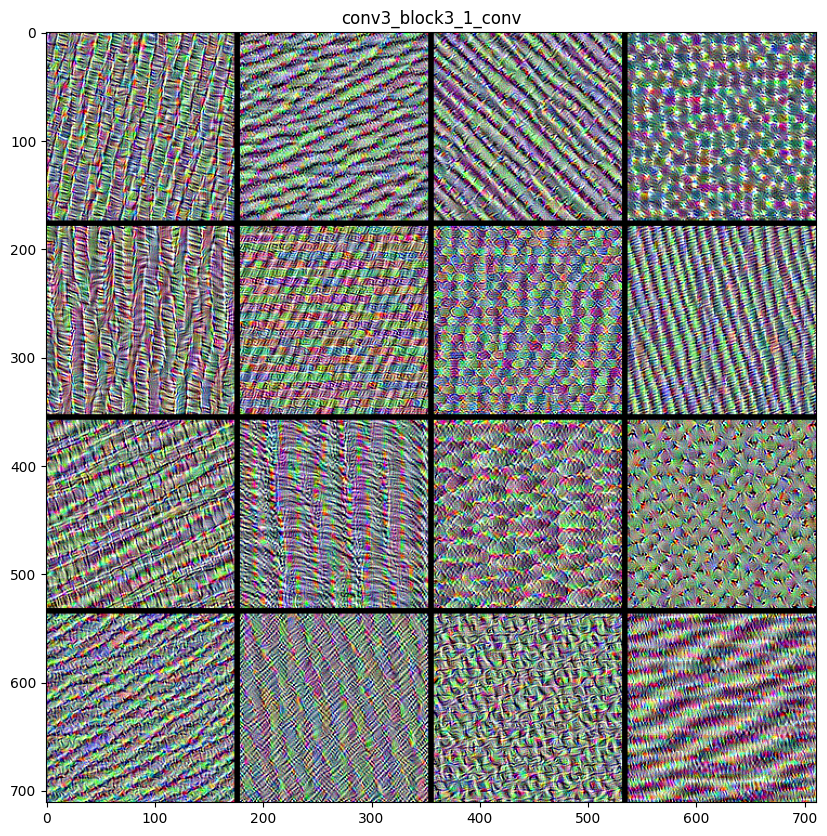


conv3_block4_1_conv

Processing filter 0
Processing filter 1
Processing filter 2
Processing filter 3
Processing filter 4
Processing filter 5
Processing filter 6
Processing filter 7
Processing filter 8
Processing filter 9
Processing filter 10
Processing filter 11
Processing filter 12
Processing filter 13
Processing filter 14
Processing filter 15


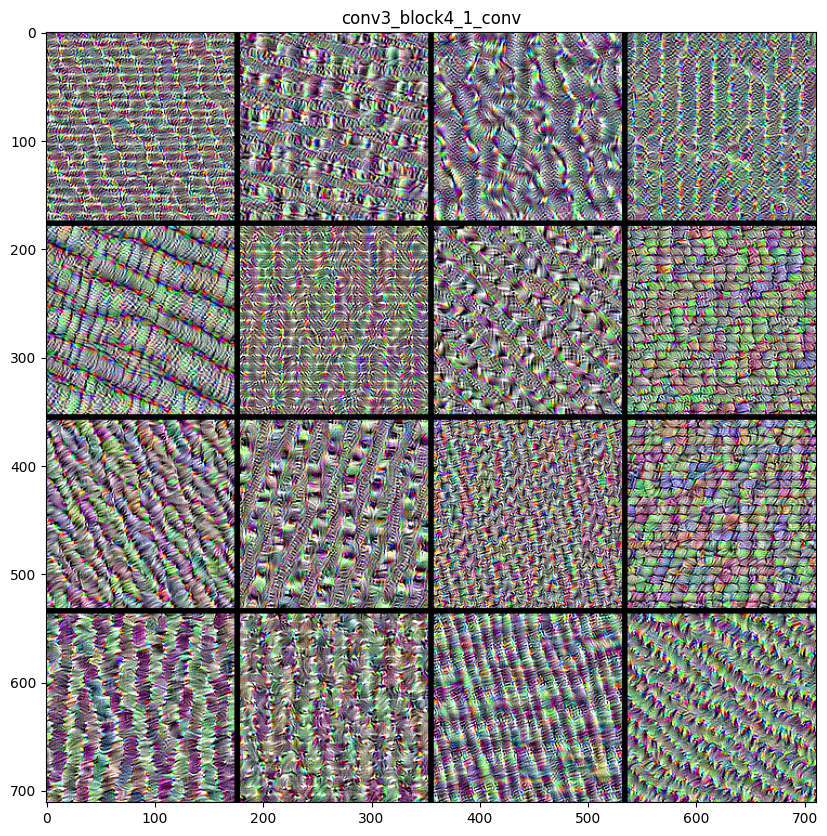

In [ ]:
for blk in [2,3,4]:
  layer_name = f"conv3_block{blk}_1_conv"
  print()
  print(layer_name)
  print()
  all_images = []
  for filter_index in range(16): # we are just considering the first 16 filters!
      print(f"Processing filter {filter_index}")
      image = deprocess_image(
          generate_filter_pattern(layer_name, filter_index)
      )
      all_images.append(image)

  margin = 5
  n = 4
  cropped_width = img_width - 25 * 2
  cropped_height = img_height - 25 * 2
  width = n * cropped_width + (n - 1) * margin
  height = n * cropped_height + (n - 1) * margin
  stitched_filters = np.zeros((width, height, 3))

  for i in range(n):
      for j in range(n):
          image = all_images[i * n + j]
          stitched_filters[
              (cropped_width + margin) * i : (cropped_width + margin) * i + cropped_width,
              (cropped_height + margin) * j : (cropped_height + margin) * j
              + cropped_height,
              :,
          ] = image

  plt.figure(figsize=(10, 10))
  plt.title(layer_name)
  plt.imshow(stitched_filters.astype("uint8"))
  plt.show()

# Heatmaps of class activation

In [ ]:
MODELS_DIR = "/content/drive/My Drive/project/models/"
model = tf.keras.models.load_model(MODELS_DIR + 'garbage_classification_pretrained_base.h5')

In [ ]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.math.truediv (TFOpLambda  (None, 224, 224, 3)      0         
 )                                                               
                                                                 
 tf.math.subtract (TFOpLambd  (None, 224, 224, 3)      0         
 a)                                                              
                                                                 
 resnet50v2 (Functional)     (None, 7, 7, 2048)        23564800  
                                                                 
 my_glo_avg_pool (GlobalAver  (None, 2048)             0         
 agePooling2D)                                                   
                                                             

In [ ]:
test_dir = dataset_path + "/test_set"
test_dataset = image_dataset_from_directory(
    test_dir,
    color_mode='rgb',
    labels='inferred',
    label_mode='categorical',
    shuffle=False,
    image_size=(224, 224),
    batch_size=1)

Found 2328 files belonging to 8 classes.


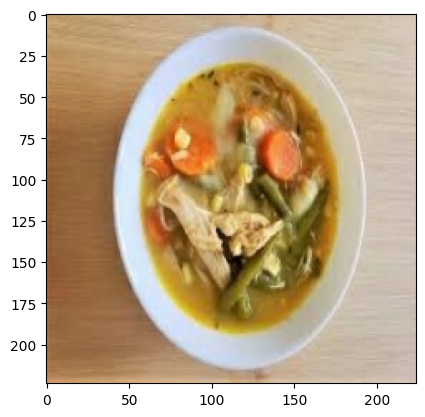

In [ ]:
test_iterator = iter(test_dataset)
random_index = rn.randint(0, len(test_dataset) - 1)
for i in range(random_index):
    next(test_iterator)

image, label = next(test_iterator)
image = tf.squeeze(image)

plt.imshow(image.numpy().astype("uint8"))
plt.show()

In [ ]:
layer_outputs = model.get_layer('resnet50v2').get_layer('conv5_block3_3_conv').output
last_conv_layer = model.get_layer('resnet50v2').get_layer('conv5_block3_3_conv')
layer_inputs = model.get_layer('resnet50v2').get_layer('input_1').input
last_conv_layer_model = Model(inputs=layer_inputs, outputs=layer_outputs)

In [ ]:
classifier_layer_names = [
    "my_glo_avg_pool",
    "predictions",
]
classifier_input = keras.Input(shape=last_conv_layer.output.shape[1:])

x = classifier_input
for layer_name in classifier_layer_names:
    x = model.get_layer(layer_name)(x)
classifier_model = keras.Model(classifier_input, x)

In [ ]:
with tf.GradientTape() as tape:
    last_conv_layer_output = last_conv_layer_model(input_image_batch) 
    tape.watch(last_conv_layer_output)
    preds = classifier_model(last_conv_layer_output)  
    top_pred_index = tf.argmax(preds[0])  
    top_class_channel = preds[:, top_pred_index]
    print(top_pred_index)
    print(top_class_channel)

grads = tape.gradient(top_class_channel, last_conv_layer_output) 

tf.Tensor(4, shape=(), dtype=int64)
tf.Tensor([0.9819692], shape=(1,), dtype=float32)


TensorShape([1, 7, 7, 2048])

In [ ]:
pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2)).numpy() 
print(pooled_grads.shape)
weighted_last_conv_layer_output = last_conv_layer_output.numpy()[0]
for i in range(pooled_grads.shape[-1]):
    weighted_last_conv_layer_output[:, :, i] *= pooled_grads[i]

(2048,)


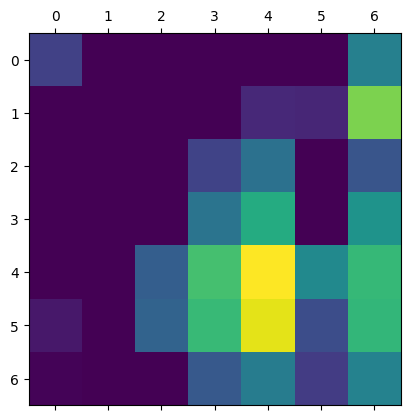

In [ ]:
heatmap = np.mean(weighted_last_conv_layer_output, axis=-1)
heatmap = np.maximum(heatmap, 0)
heatmap /= np.max(heatmap)
plt.matshow(heatmap)

In [ ]:
img = image

heatmap = np.uint8(255 * heatmap)

jet = mpl.colormaps["jet"]
jet_colors = jet(np.arange(256))[:, :3]
jet_heatmap = jet_colors[heatmap]

jet_heatmap = keras.utils.array_to_img(jet_heatmap)
jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
jet_heatmap = keras.utils.img_to_array(jet_heatmap)

superimposed_img = jet_heatmap * 0.4 + img
superimposed_img = keras.utils.array_to_img(superimposed_img)

save_path = "image.jpg"
superimposed_img.save(save_path)

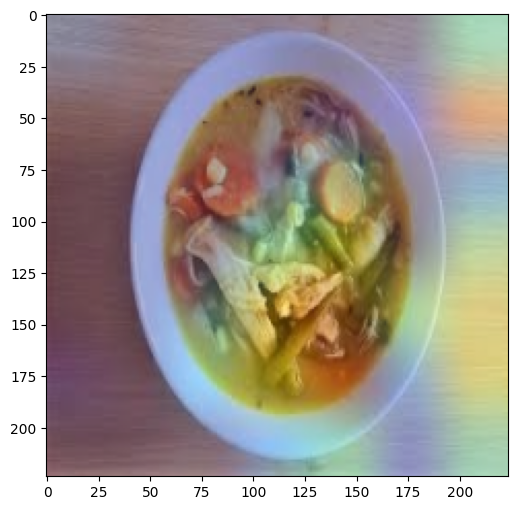

In [ ]:
plt.figure(figsize= (6,6))
plt.imshow(superimposed_img)